# Example of functional MRI connectivity

In [ ]:
import os
import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import IFrame, Image

In [3]:
%matplotlib inline

## Getting data

In [4]:
import nibabel as nib
from bids import BIDSLayout

In [5]:
!ls ds000105/derivatives

dataset_description.json  mriqc       sub-2	  sub-4       sub-6
desc-aparcaseg_dseg.tsv   sourcedata  sub-2.html  sub-4.html  sub-6.html
desc-aseg_dseg.tsv	  sub-1       sub-3	  sub-5
logs			  sub-1.html  sub-3.html  sub-5.html


In [6]:
data_dir = 'ds000105'
bids_layout = BIDSLayout(data_dir, derivatives=True)
bids_layout

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/bids/layout/models.py:148: FutureWarning: The 'extension' entity currently excludes the leading dot ('.'). As of version 0.14.0, it will include the leading dot. To suppress this warning and include the leading dot, use `bids.config.set_option('extension_initial_dot', True)`.
  warnings.warn("The 'extension' entity currently excludes the leading dot ('.'). "


BIDS Layout: ...ta/projects/NIDS-fmri/ds000105 | Subjects: 6 | Sessions: 0 | Runs: 71

In [7]:
bids_layout.get_subjects()

['1', '2', '3', '4', '5', '6']

In [8]:
sub_id = "1"

### Example of subject 1 / run 1

In [9]:
run_id = "1"

In [10]:
# Get TR
tr = bids_layout.get_tr(subject=sub_id, run=run_id)
# Get 4D fmri data
func_file = bids_layout.get(scope="derivatives", subject=sub_id, run=run_id, datatype='func',
                            extension='nii.gz', suffix="bold")[0]
func_file_img = nib.load(func_file)
# Get fmri mask
func_mask_file = bids_layout.get(scope="derivatives", subject=sub_id, run=run_id, datatype='func',
                                 extension='nii.gz', suffix="mask", return_type='filename')[0]
# Get nuisance regressors
confounds_file = bids_layout.get(scope='fMRIPrep', desc='confounds', extension='tsv', 
                                 subject=sub_id, run=run_id)[0]
confounds_df = confounds_file.get_df()
motion_outliers = [c for c in confounds_df.columns if c.startswith('motion_outlier')]
nuisance_cols = ['csf', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y', 'rot_z']
nuisance_regs = confounds_df[nuisance_cols + motion_outliers]
# Get 3D T1 data
t1_file = bids_layout.get(scope="derivatives", subject=sub_id, datatype='anat', 
                          desc='preproc', space='MNI152NLin2009cAsym', extension='nii.gz')[0]
t1_file_img = nib.load(t1_file)

In [11]:
from nilearn.glm.first_level import FirstLevelModel

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/glm/__init__.py:55: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  warn('The nilearn.glm module is experimental. '


### Harvard Oxford atlas

In [12]:
from nilearn.datasets import fetch_atlas_harvard_oxford
from nilearn.image import resample_to_img
from nilearn import plotting

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/datasets/__init__.py:87: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  warn("Fetchers from the nilearn.datasets module will be "


In [13]:
# harvard_oxford_atlas is a dictionary with the keys "labels" and "maps"
# We use the subcortical "maxprob" atlas, thresholded at 25 probability
harvard_oxford_atlas = fetch_atlas_harvard_oxford('cort-maxprob-thr25-2mm',
                                                 data_dir='./atlases')
# Get maps and labels
harvard_oxford_maps = harvard_oxford_atlas['maps']
harvard_oxford_labels = harvard_oxford_atlas['labels']
# Load atlas image with nibabel
harvard_oxford_img = nib.load(harvard_oxford_maps)
print(f"Shape of map: {harvard_oxford_img.shape}") 

Shape of map: (91, 109, 91)


In [14]:
harvard_oxford_img_resampled = resample_to_img(source_img=harvard_oxford_img, 
                                               target_img=func_file_img,
                                               interpolation='nearest')
print(f"Shape of resampled map: {harvard_oxford_img_resampled.shape}")

Shape of resampled map: (56, 62, 53)



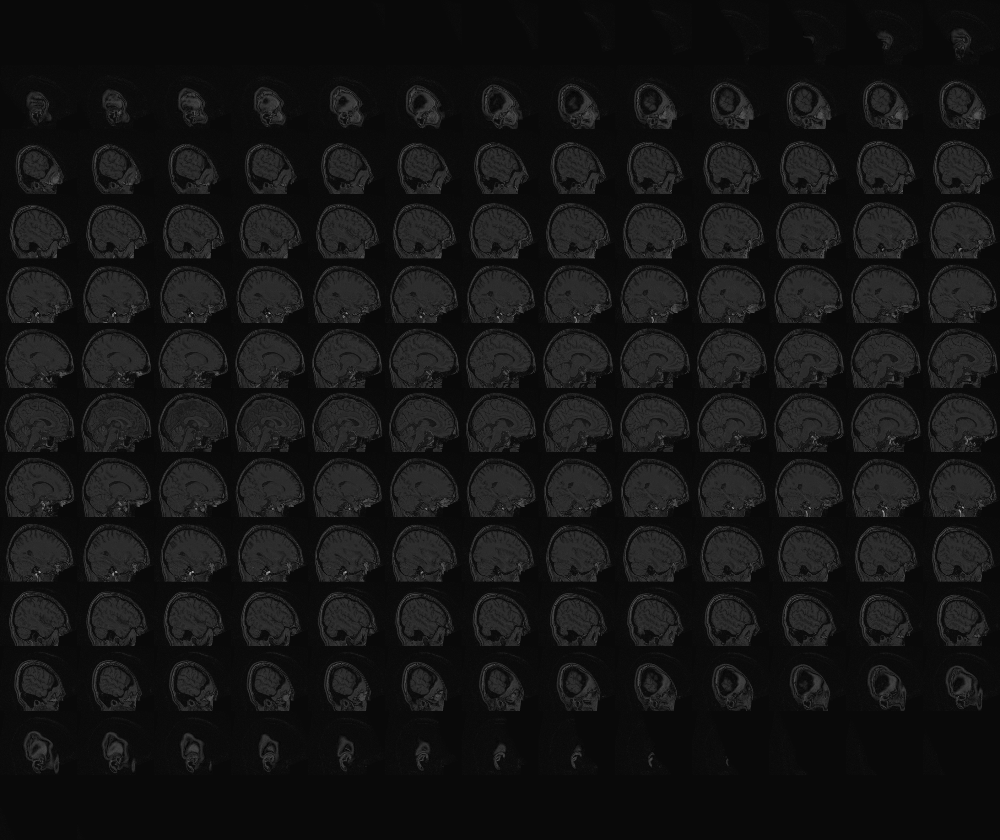
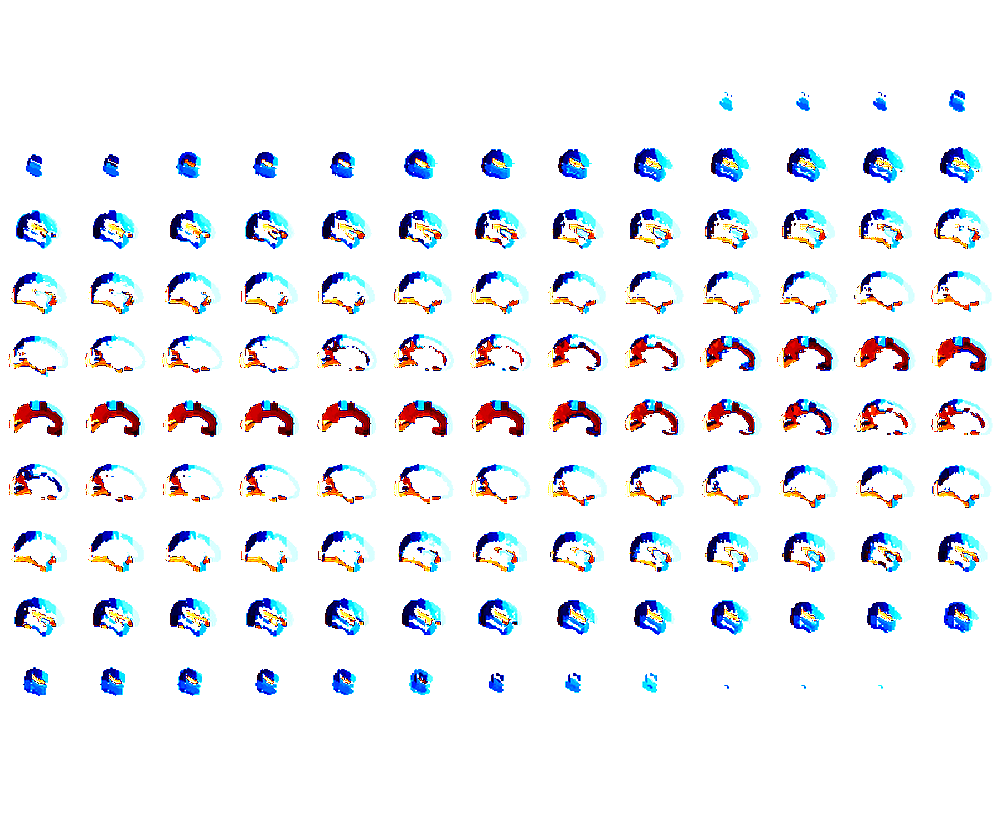

In [15]:
plotting.view_img(harvard_oxford_img_resampled, bg_img=t1_file_img,
                  title="Harvard Oxford atlas",
                  symmetric_cmap=False, opacity=0.4)

#### Visualize a specific ROI, say the Posterior Cingulate Cortex (PCC)

In [16]:
harvard_oxford_labels

['Background',
 'Frontal Pole',
 'Insular Cortex',
 'Superior Frontal Gyrus',
 'Middle Frontal Gyrus',
 'Inferior Frontal Gyrus, pars triangularis',
 'Inferior Frontal Gyrus, pars opercularis',
 'Precentral Gyrus',
 'Temporal Pole',
 'Superior Temporal Gyrus, anterior division',
 'Superior Temporal Gyrus, posterior division',
 'Middle Temporal Gyrus, anterior division',
 'Middle Temporal Gyrus, posterior division',
 'Middle Temporal Gyrus, temporooccipital part',
 'Inferior Temporal Gyrus, anterior division',
 'Inferior Temporal Gyrus, posterior division',
 'Inferior Temporal Gyrus, temporooccipital part',
 'Postcentral Gyrus',
 'Superior Parietal Lobule',
 'Supramarginal Gyrus, anterior division',
 'Supramarginal Gyrus, posterior division',
 'Angular Gyrus',
 'Lateral Occipital Cortex, superior division',
 'Lateral Occipital Cortex, inferior division',
 'Intracalcarine Cortex',
 'Frontal Medial Cortex',
 'Juxtapositional Lobule Cortex (formerly Supplementary Motor Cortex)',
 'Subcallo

In [17]:
# Extract the roi integer label and use it to create a mask
roi_ix = harvard_oxford_labels.index('Cingulate Gyrus, posterior division')
roi_mask = (harvard_oxford_img_resampled.get_fdata() == roi_ix)
roi_mask_int = nib.Nifti1Image(roi_mask.astype(int), affine=harvard_oxford_img_resampled.affine)

##### Compute the center of mass of the mask and apply the affine transform for visualization

In [18]:
from scipy.ndimage.measurements import center_of_mass
from nibabel.affines import apply_affine

In [19]:
pcc_com = center_of_mass(roi_mask.astype(int))
pcc_com

(27.786458333333332, 25.588541666666668, 29.013020833333332)

In [20]:
affine_xfm = harvard_oxford_img_resampled.affine
pcc_com_mni = apply_affine(affine_xfm, center_of_mass(roi_mask.astype(int)))
pcc_com_mni

array([  0.75260417, -36.54296875,  30.29882812])

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/image/resampling.py:527: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/image/resampling.py:273: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn("Resampling binary images with continuous or "



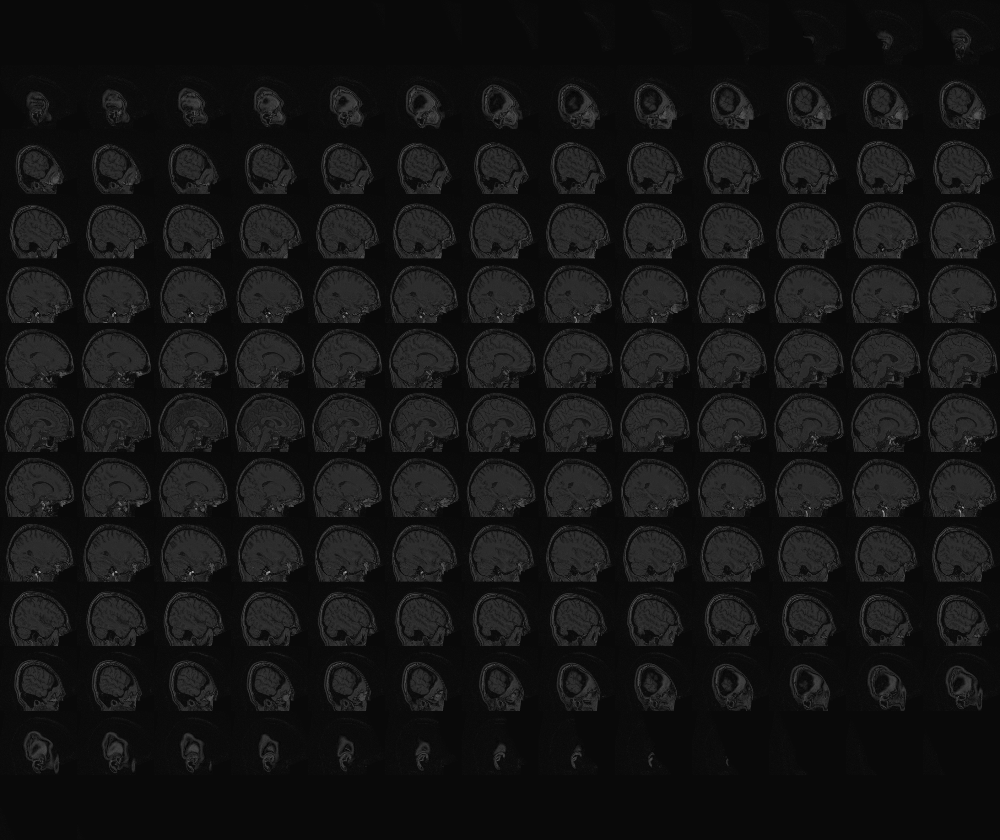
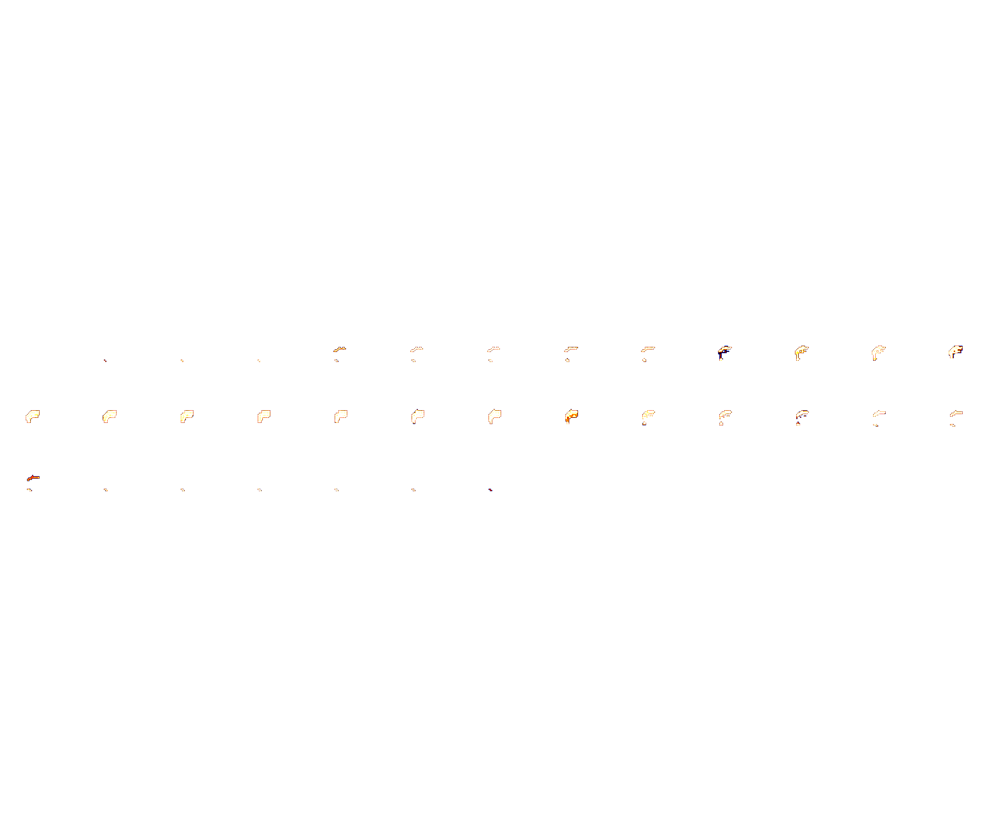

In [21]:
plotting.view_img(roi_mask_int, bg_img=t1_file_img,
                  title="Harvard Oxford atlas", cut_coords=pcc_com_mni,
                  symmetric_cmap=False, opacity=0.4)

#### Plot the signal

In [22]:
from nilearn.masking import apply_mask

In [23]:
roi_time_series = apply_mask(func_file_img, roi_mask_int)

In [24]:
apply_mask?

In [25]:
roi_mask_int.get_fdata().sum()

384.0

In [26]:
func_file_img.shape

(56, 62, 53, 121)

In [27]:
roi_time_series.shape

(121, 384)

In [28]:
roi_mean_ts = roi_time_series.mean(axis=1)

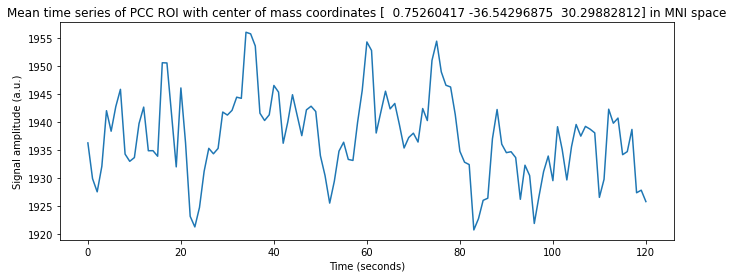

In [29]:
plt.figure(figsize=(11, 4))
plt.plot(roi_mean_ts)
plt.xlabel('Time (seconds)')
plt.ylabel('Signal amplitude (a.u.)')
plt.title(f'Mean time series of PCC ROI with center of mass coordinates {pcc_com_mni} in MNI space');

## Cleaning the data

In [30]:
from nilearn.glm.first_level import FirstLevelModel
from nilearn.plotting import plot_design_matrix

In [31]:
FirstLevelModel?

### Manually (i.e. with GLM model based on confounds)

In [32]:
# Create design matrix
n_tr = func_file_img.get_fdata().shape[3]
scan_times = np.linspace(tr/2, tr/2 + tr*n_tr, n_tr, endpoint=False)

In [33]:
from nilearn.glm.first_level import make_first_level_design_matrix

In [34]:
design_matrix = make_first_level_design_matrix(frame_times=scan_times,  
                                               hrf_model=None, 
                                               drift_model='cosine', 
                                               high_pass=0.01, 
                                               add_regs=nuisance_regs)

In [35]:
make_first_level_design_matrix?

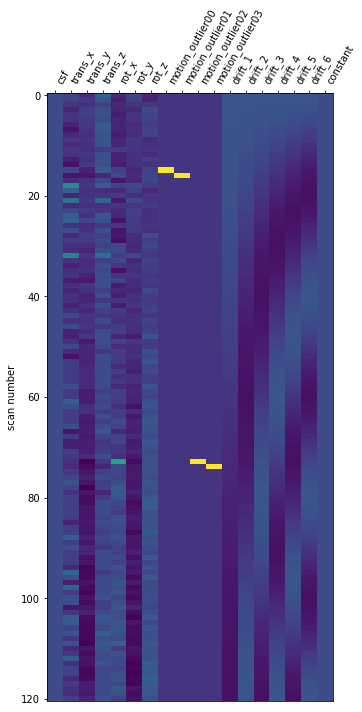

In [36]:
plot_design_matrix(design_matrix);

In [37]:
make_first_level_design_matrix?

In [38]:
FirstLevelModel?

In [39]:
# Define first level model
flm = FirstLevelModel(mask_img=func_mask_file, smoothing_fwhm=None,
                      noise_model='ols', n_jobs=1, standardize=False,
                      minimize_memory=False, subject_label=sub_id)

In [40]:
flm.fit(run_imgs=func_file_img, design_matrices=design_matrix)

FirstLevelModel(mask_img='/mnt/linux_data/projects/NIDS-fmri/ds000105/derivatives/sub-1/func/sub-1_task-objectviewing_run-1_space-MNI152NLin2009cAsym_desc-brain_mask.nii.gz',
                minimize_memory=False, noise_model='ols', signal_scaling=True,
                subject_label='1')

In [41]:
func_img_clean = flm.residuals[0]

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/glm/regression.py:359: FutureWarning: 'resid' from RegressionResults has been deprecated and will be removed. Please use 'residuals' instead.
  warnings.warn("'resid' from RegressionResults "


In [42]:
# Compare time series before and after cleaning
roi_time_series_clean = apply_mask(func_img_clean, roi_mask_int)
roi_mean_ts_clean = roi_time_series_clean.mean(axis=1)

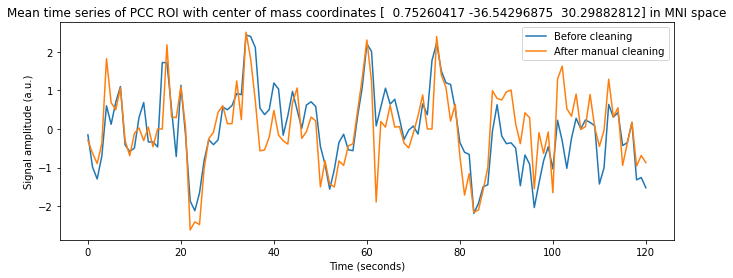

In [43]:
plt.figure(figsize=(11, 4))
plt.plot((roi_mean_ts - roi_mean_ts.mean())/roi_mean_ts.std(),
         label='Before cleaning')
plt.plot((roi_mean_ts_clean - roi_mean_ts_clean.mean())/roi_mean_ts_clean.std(),
         label='After manual cleaning')
plt.xlabel('Time (seconds)')
plt.ylabel('Signal amplitude (a.u.)')
plt.title(f'Mean time series of PCC ROI with center of mass coordinates {pcc_com_mni} in MNI space')
plt.legend();

### With nilearn clean function

In [44]:
from nilearn.image import clean_img

In [45]:
func_img_niclean = clean_img(func_file_img, detrend=True, standardize=False, 
                             confounds=nuisance_regs, high_pass=0.01, t_r=tr, 
                             mask_img=func_mask_file)

In [46]:
# Compare time series based on "manual" or nilearn clean function approach
roi_time_series_niclean = apply_mask(func_img_niclean, roi_mask_int)
roi_mean_ts_niclean = roi_time_series_niclean.mean(axis=1)

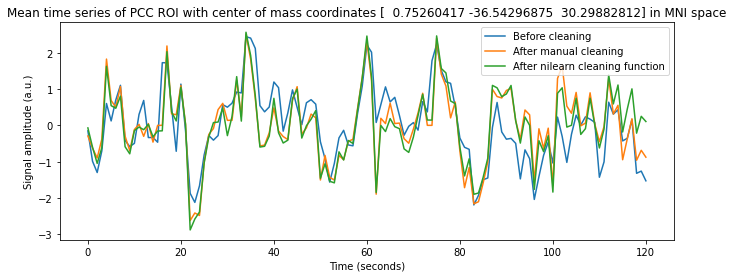

In [47]:
plt.figure(figsize=(11, 4))
plt.plot((roi_mean_ts - roi_mean_ts.mean())/roi_mean_ts.std(),
         label='Before cleaning')
plt.plot((roi_mean_ts_clean - roi_mean_ts_clean.mean())/roi_mean_ts_clean.std(),
         label='After manual cleaning')
plt.plot((roi_mean_ts_niclean - roi_mean_ts_niclean.mean())/roi_mean_ts_niclean.std(),
         label='After nilearn cleaning function')
plt.xlabel('Time (seconds)')
plt.ylabel('Signal amplitude (a.u.)')
plt.title(f'Mean time series of PCC ROI with center of mass coordinates {pcc_com_mni} in MNI space')
plt.legend();

### Both fitting and ROI extraction in a single step with nilearn masker function

In [48]:
from nilearn import input_data

In [49]:
roi_masker = input_data.NiftiMasker(mask_img=roi_mask_int, smoothing_fwhm=None, detrend=True,
                                    standardize=False, high_pass=0.01, t_r=tr)

In [50]:
roi_time_series_nimasker = roi_masker.fit_transform(func_file_img, confounds=nuisance_regs)
roi_mean_ts_nimasker = roi_time_series_niclean.mean(axis=1)

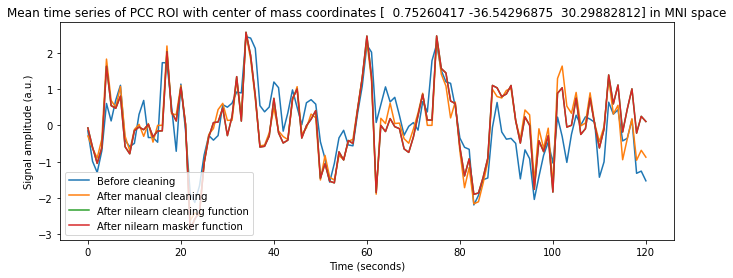

In [51]:
plt.figure(figsize=(11, 4))
plt.plot((roi_mean_ts - roi_mean_ts.mean())/roi_mean_ts.std(),
         label='Before cleaning')
plt.plot((roi_mean_ts_clean - roi_mean_ts_clean.mean())/roi_mean_ts_clean.std(),
         label='After manual cleaning')
plt.plot((roi_mean_ts_niclean - roi_mean_ts_niclean.mean())/roi_mean_ts_niclean.std(),
         label='After nilearn cleaning function')
plt.plot((roi_mean_ts_nimasker - roi_mean_ts_nimasker.mean())/roi_mean_ts_nimasker.std(),
         label='After nilearn masker function')
plt.xlabel('Time (seconds)')
plt.ylabel('Signal amplitude (a.u.)')
plt.title(f'Mean time series of PCC ROI with center of mass coordinates {pcc_com_mni} in MNI space')
plt.legend();

#### Using Nifti Masker as our final choice for whole brain cleaning

In [52]:
brain_masker = input_data.NiftiMasker(mask_img=func_mask_file, smoothing_fwhm=6, detrend=True,
                                      standardize=False, low_pass=0.08, high_pass=0.01, t_r=tr)

In [53]:
ts_clean = brain_masker.fit_transform(func_file_img, confounds=nuisance_regs)
ts_clean.shape

(121, 43054)

## Seed correlation analysis

### Extract clean signal in ROI

In [54]:
# We can convert ts_clean back into an image
ts_clean_img = brain_masker.inverse_transform(ts_clean)

In [55]:
# And now get mean signal in ROI
roi_ts_clean = apply_mask(ts_clean_img, roi_mask_int)
roi_mean_ts_clean = roi_time_series_niclean.mean(axis=1)

In [56]:
ts_clean.shape

(121, 43054)

In [57]:
# We can loop on all brain voxels to compute correlation with seed ROI
brain_corr = np.zeros(ts_clean.shape[1])
for i_v, voxel in enumerate(range(len(brain_corr))):
    brain_corr[i_v] = np.corrcoef(roi_mean_ts_clean, ts_clean[:, i_v])[0, 1]

In [58]:
# Convert the vector of correlations back to the shape of the original image
brain_corr_img = brain_masker.inverse_transform(brain_corr)


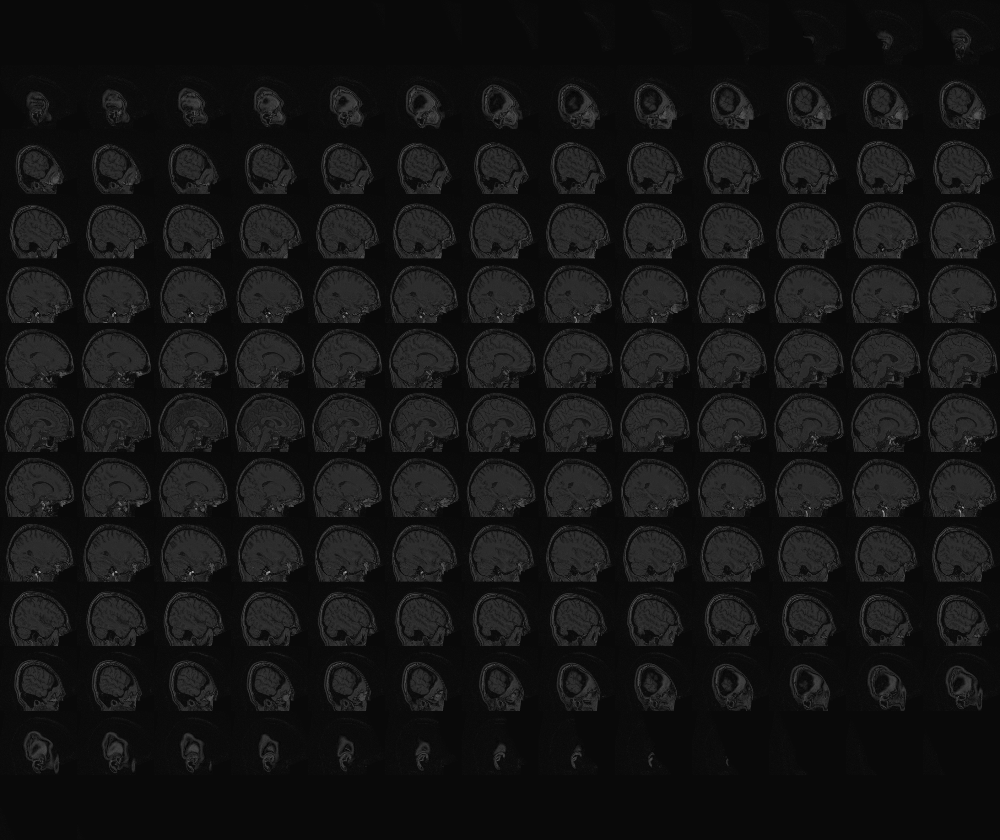
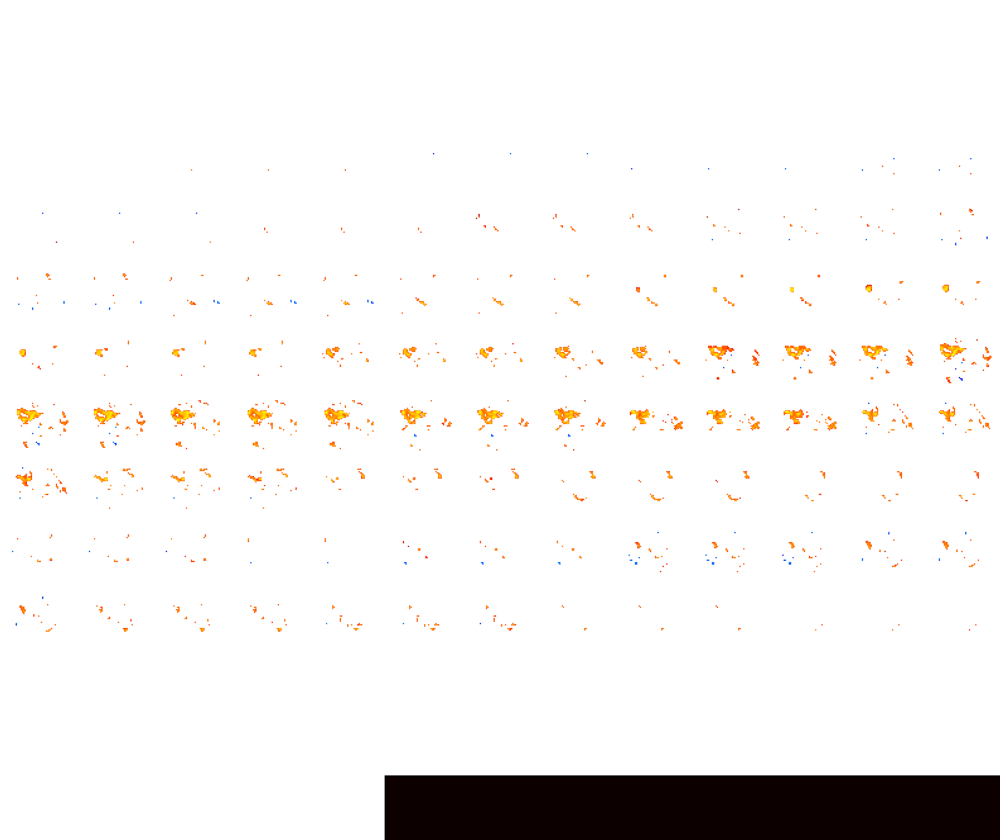

In [59]:
plotting.view_img(brain_corr_img, bg_img=t1_file_img, threshold=0.5, vmax=1,
                  title="Correlation with PCC", cut_coords=pcc_com_mni)

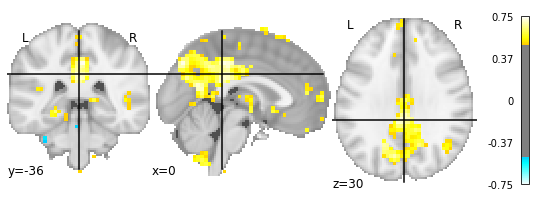

In [60]:
plotting.plot_stat_map(brain_corr_img, threshold=0.5, cut_coords=pcc_com_mni);

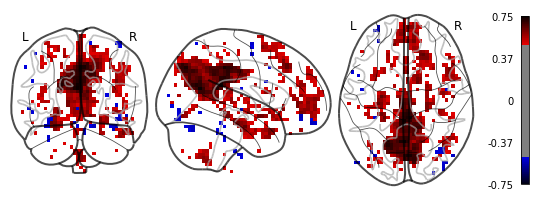

In [61]:
plotting.plot_glass_brain(brain_corr_img, threshold=0.5,
                          colorbar=True, plot_abs=False);

In [62]:
plotting.plot_glass_brain?

#### Plotting the r-to-z transformed correlation scores

In [63]:
brain_corr_z = np.arctanh(brain_corr)

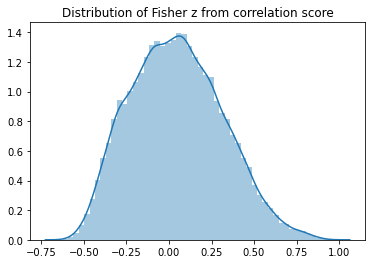

In [64]:
sns.distplot(brain_corr_z)
plt.title('Distribution of Fisher z from correlation score');

## Constructing brain networks

### Getting mean time series within each ROI of an atlas / parcellation

The class `NiftiLabelsMasker` allows to clean the fMRI signal and extract mean signal for each ROI of an atlas parcellation. 

In [65]:
from nilearn.input_data import NiftiLabelsMasker

In [66]:
atlas_masker = NiftiLabelsMasker(labels_img=harvard_oxford_maps, mask_img=func_mask_file, 
                                 smoothing_fwhm=6, detrend=True, standardize=False, 
                                 low_pass=0.08, high_pass=0.01, t_r=tr)

In [67]:
atlas_ts = atlas_masker.fit_transform(func_file_img, confounds=nuisance_regs)

In [68]:
atlas_ts.shape

(121, 48)

### Computing a connectivity matrix / connectome according to a connectivity metric

In [69]:
from nilearn.connectome import ConnectivityMeasure

#### Correlation

In [70]:
correlation_measure = ConnectivityMeasure(kind='correlation')
correlation_matrix = correlation_measure.fit_transform([atlas_ts])[0]

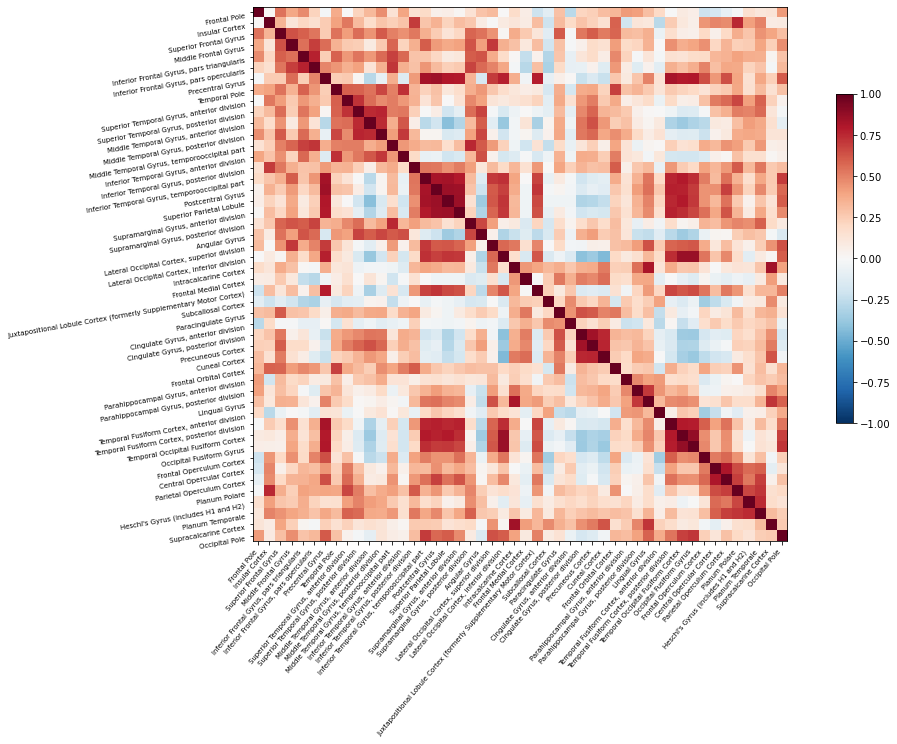

In [71]:
plotting.plot_matrix(correlation_matrix, figure=(11, 11), labels=harvard_oxford_labels[1:],
                     vmax=1.0, vmin=-1.0);

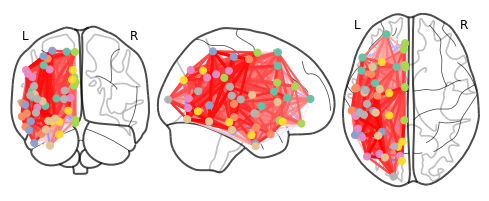

In [72]:
coords = plotting.find_parcellation_cut_coords(harvard_oxford_maps)
plotting.plot_connectome(correlation_matrix, coords)

In [73]:
plotting.view_connectome(correlation_matrix, coords)

#### Partial correlation

In [74]:
pcorrelation_measure = ConnectivityMeasure(kind='partial correlation')
pcorrelation_matrix = pcorrelation_measure.fit_transform([atlas_ts])[0]

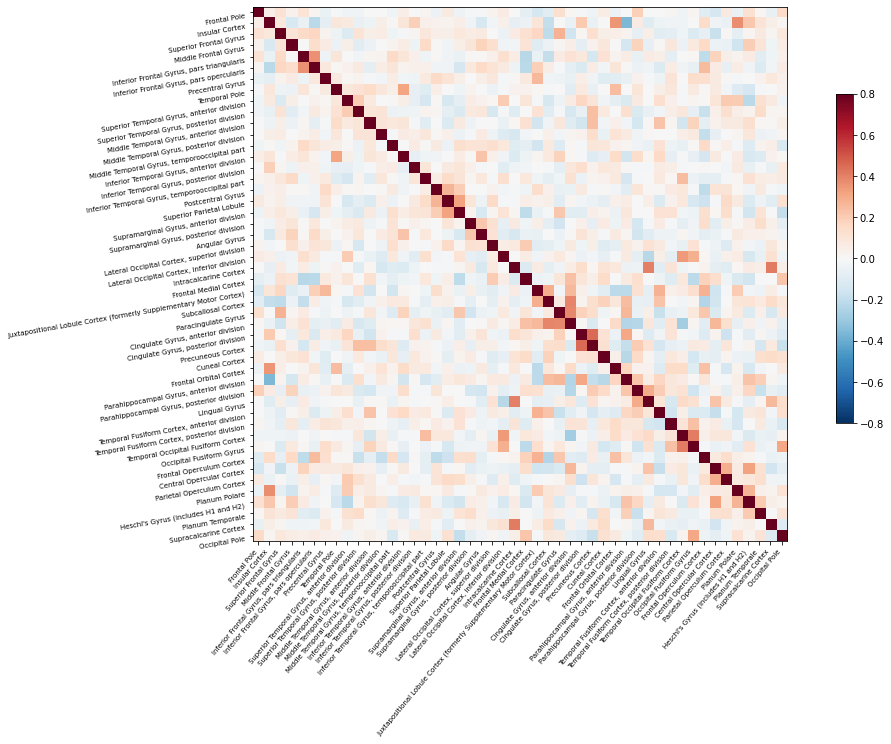

In [75]:
plotting.plot_matrix(pcorrelation_matrix, figure=(11, 11), labels=harvard_oxford_labels[1:],
                     vmax=0.8, vmin=-0.8);

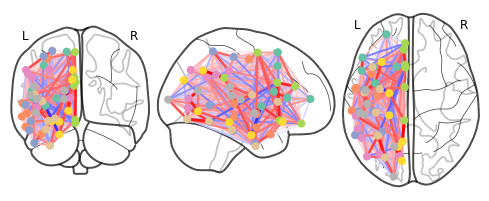

In [76]:
plotting.plot_connectome(pcorrelation_matrix, coords);

#### Sparse inverse covariance

In [77]:
from sklearn.covariance import GraphicalLassoCV

In [78]:
estimator = GraphicalLassoCV()
estimator.fit(atlas_ts)

GraphicalLassoCV()

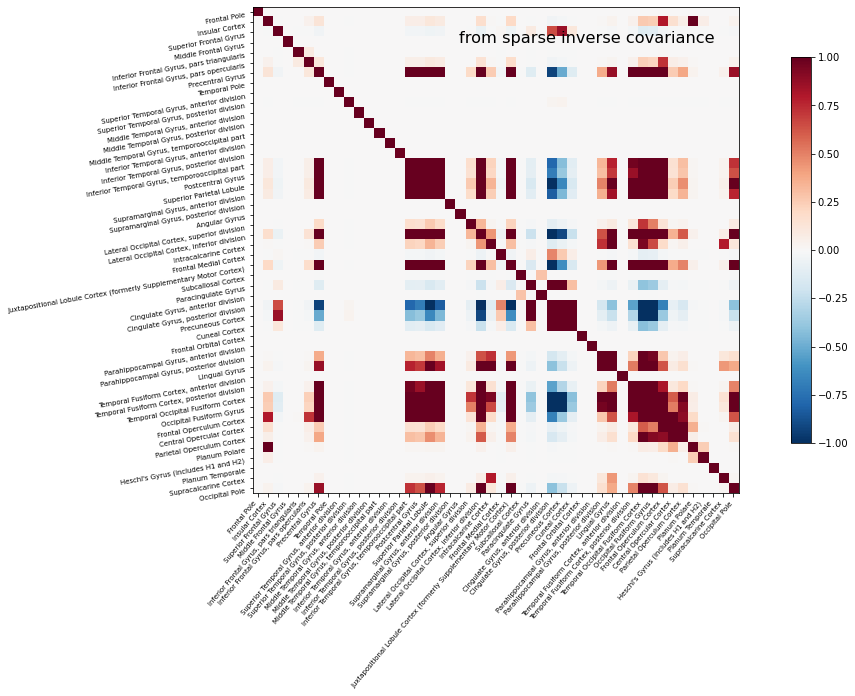

In [79]:
plotting.plot_matrix(estimator.covariance_, figure=(10, 12), labels=harvard_oxford_labels[1:],
                     vmax=1.0, vmin=-1.0, title='from sparse inverse covariance');

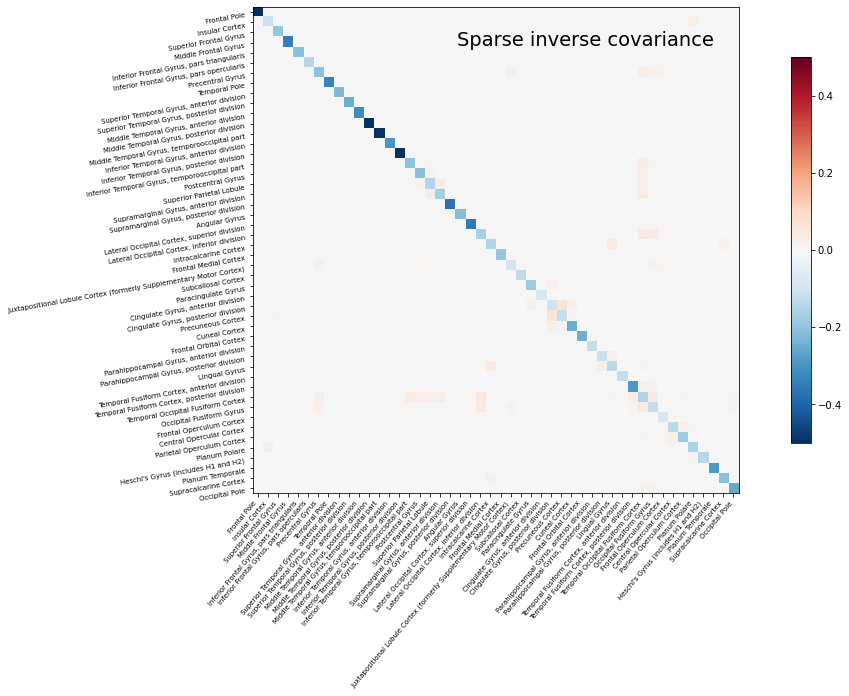

In [80]:
plotting.plot_matrix(-estimator.precision_, labels=harvard_oxford_labels[1:],
                     figure=(10, 12), vmax=0.5, vmin=-0.5,
                     title='Sparse inverse covariance');

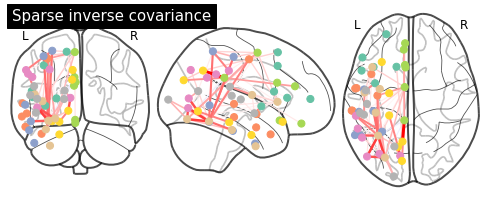

In [81]:
plotting.plot_connectome(-estimator.precision_, coords, title='Sparse inverse covariance');

In [82]:
plotting.view_connectome(-estimator.precision_, coords)

## Predicting outcome from connectome

Adapted from [this tutorial](https://github.com/esfinn/cpm_tutorial)

### Get data

Human Connectome Project data with 1200 subjects. Sub-selection of 337 unrelated subjects.

In [83]:
conmats_root_dir = 'conmats_data'
conmats_data_dir = os.path.join(conmats_root_dir, 'fc_data')
subset337_file = os.path.join(conmats_root_dir, 'unrelated_subIDs_n337.txt')
behavioral_file = os.path.join(conmats_root_dir, 'unrestricted_behav_data_n337.csv')

In [84]:
# Get list of subjects
subj_list = np.loadtxt(subset337_file, dtype=int)
# Get subject behavioral data
all_behav_data = pd.read_csv(behavioral_file, dtype={'Subject': str})
all_behav_data.set_index('Subject', inplace=True)

In [85]:
all_behav_data

,Release,Acquisition,Gender,Age,3T_Full_MR_Compl,T1_Count,T2_Count,3T_RS-fMRI_Count,3T_RS-fMRI_PctCompl,3T_Full_Task_fMRI,...,Noise_Comp,Odor_Unadj,Odor_AgeAdj,PainIntens_RawScore,PainInterf_Tscore,Taste_Unadj,Taste_AgeAdj,Mars_Log_Score,Mars_Errs,Mars_Final
Subject,,,,,,,,,,,,,,,,,,,,,
100206,S900,Q11,M,26-30,True,1,1,4,100,True,...,6.0,108.79,97.19,1.0,49.7,72.63,72.03,1.84,0.0,1.84
100610,S900,Q08,M,26-30,True,2,1,4,100,True,...,2.0,122.25,110.45,0.0,38.6,84.84,85.31,1.92,1.0,1.88
101006,S500,Q06,F,31-35,True,2,2,4,100,True,...,6.0,122.25,111.41,0.0,38.6,123.80,123.31,1.80,0.0,1.80
101309,S500,Q06,M,26-30,True,1,1,4,100,True,...,5.2,122.25,110.45,0.0,38.6,106.39,104.39,1.80,0.0,1.80
101915,Q3,Q04,F,31-35,True,2,2,4,100,True,...,4.4,96.87,77.61,0.0,38.6,112.11,111.70,1.84,1.0,1.80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
966975,S900,Q12,M,22-25,True,2,2,4,100,True,...,3.6,122.25,110.45,0.0,38.6,84.07,84.25,1.80,0.0,1.80
984472,Q2,Q02,F,26-30,True,1,1,4,100,True,...,2.8,122.25,110.45,0.0,38.6,108.73,108.00,1.76,0.0,1.76
987983,S500,Q04,F,26-30,True,2,2,4,100,True,...,5.2,108.79,97.19,5.0,56.4,88.02,87.70,1.88,0.0,1.88


In [86]:
def read_in_matrices(subj_list, file_keyword='', conmats_data_dir=conmats_data_dir, zscore=False):
    """
    Reads in a set of individual-subject connectivity matrices stored in data_dir,
    
    Returns a dataframe that is subjects x edges (by vectorizing the upper triangle of each FC matrix).
    
    Assumes:
    - each matrix is stored in a separate file beginning with the subject ID, and
    - matrices are symmetric (squareform); i.e., for a parcellation with 268 nodes, 
    matrices should be 268 x 268
    """
    
    all_fc_data_dict = {}
            
    for subj_id in subj_list:
        subj = str(subj_id)
        # try to find this subject's matrix
        file_list = [f for f in os.listdir(conmats_data_dir) if subj in f and file_keyword in f]
            
        # make sure there is one and only one file    
        if len(file_list) == 0:
            raise ValueError(f"No data found for subject {subj}")
        elif len(file_list) > 1:
            raise ValueError(f"More than one matrix found for subject {subj}! Specify a suffix?")
        
        # read it in and make sure it's symmetric and has reasonable dimensions
        tmp_mat = np.loadtxt(os.path.join(conmats_data_dir, file_list[0]))
        assert tmp_mat.shape[0]==tmp_mat.shape[1]>1, "Matrix seems to have incorrect dimensions: {tmp_mat.shape}"
        
        # take just the upper triangle and store it in a dictionary
        if zscore:
            all_fc_data_dict[subj] = sp.stats.zscore(tmp_mat[np.triu_indices_from(tmp_mat, k=1)])
        else:
            all_fc_data_dict[subj] = tmp_mat[np.triu_indices_from(tmp_mat, k=1)]
        
    # Convert dictionary into dataframe
    all_fc_data = pd.DataFrame.from_dict(all_fc_data_dict, orient='index')
    return all_fc_data

In [87]:
all_fc_data_rest = read_in_matrices(subj_list, file_keyword='REST')

In [88]:
all_fc_data_rest

,0,1,2,3,4,5,6,7,8,9,...,35768,35769,35770,35771,35772,35773,35774,35775,35776,35777
100206,-0.01260,0.32330,0.07675,-0.00935,0.07315,-0.03645,0.03920,-0.05085,0.11115,-0.10385,...,0.07700,-0.05335,-0.05960,0.07340,-0.07035,-0.02345,0.11240,0.08575,-0.00065,-0.04875
100610,0.02640,0.13705,0.03880,-0.00515,0.12650,0.27320,0.23310,0.16515,0.15775,0.03840,...,0.00200,0.08050,0.04145,0.06880,0.00990,0.09700,0.02340,0.09375,0.20835,0.09985
101006,-0.03290,-0.02075,-0.01470,0.08315,0.17685,0.17075,0.03220,0.02115,0.17490,0.12475,...,0.07970,-0.00350,-0.25130,-0.13555,-0.07430,-0.05355,-0.08735,0.07910,-0.01705,0.06920
101309,0.07100,0.11620,0.00425,0.03905,0.20200,0.20185,0.31185,0.11320,0.11270,0.19250,...,-0.01435,0.01745,0.01105,0.03210,0.05005,0.02760,-0.04655,0.05080,0.02065,-0.00720
101915,0.08320,0.27890,0.12290,-0.00755,0.09600,0.09895,0.21355,-0.22720,0.17240,-0.08715,...,0.06410,-0.04185,0.18670,0.09770,0.28130,0.13695,0.01230,-0.07145,0.06930,0.09660
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
966975,-0.07835,0.29575,-0.04455,0.14815,0.22870,-0.02210,0.33675,0.00880,0.18480,0.15780,...,0.02235,0.01315,0.15920,0.00080,-0.01865,0.01645,0.21175,0.18045,0.02000,0.06540
984472,0.05310,0.16125,0.02560,0.08305,0.25410,0.23590,0.24280,0.04305,0.15000,0.22405,...,0.12215,0.10065,0.05535,0.06040,0.12310,0.16410,-0.01930,0.07765,0.02300,0.11560
987983,-0.03835,0.06105,0.15160,0.08605,0.16670,0.28120,0.12945,0.33140,0.12255,0.10680,...,-0.03690,0.03500,-0.02385,-0.04950,-0.02780,0.08945,0.11120,-0.04790,-0.09730,0.12345
993675,0.02515,0.21365,0.10130,0.26620,0.09575,0.31400,0.21295,-0.12935,0.29550,-0.22510,...,0.02720,-0.02630,-0.02645,-0.01590,0.04915,0.01205,0.02490,0.07460,0.11285,0.11790


Extract connectivity matrix of first subject and plot it

In [89]:
n_edges = 268
s0_conmat = np.zeros((n_edges, n_edges))
s0_conmat_triu = all_fc_data_rest.iloc[0, :]
s0_conmat[np.triu_indices(n_edges, 1)] = s0_conmat_triu
s0_conmat += s0_conmat.T

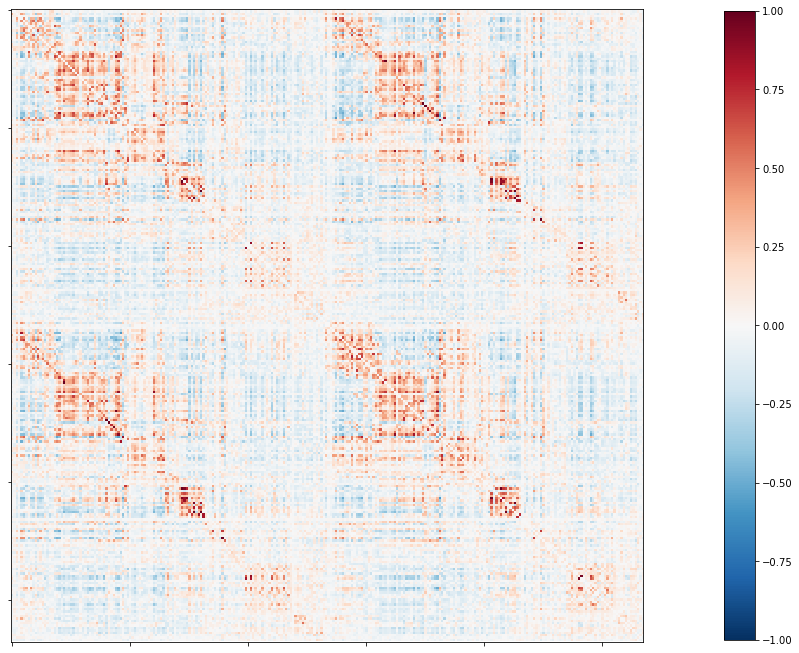

In [90]:
plotting.plot_matrix(s0_conmat, figure=(11, 11), vmax=1.0, vmin=-1.0);

### Exercise

1. **Choose one task among the following:**
  * Rest ( REST )
  * Working memory ( WM )
  * Language (LANGUAGE)
  * Gambling (GAMBLING)
  * Social (SOCIAL)
2. **Collect the associated conmat files and extract the appropriate feature matrix X**
3. **Choose one performance score among the following:**
  * PMAT24_A_CR: Fluid intelligence (# items correct on Raven's progressive matrices task)
  * ListSort_Unadj: Working memory (list sorting task)
  * PicVocab_Unadj: Picture vocabulary (verbal IQ)
  * ReadEng_Unadj: Reading (verbal IQ)
  * ProcSpeed_Unadj: Processing speed
  * PicSeq_Unadj: Episodic memory (picture sequence)
  * DDisc_AUC_40K: Measure of delay discounting
4. **Extract the appropriate label vector y**
5. **Try implementing [the paper of Shen](https://esfinn.github.io/files/Shen_NatProtocols2017.pdf)**
   1. Keep 15% of the data for final testing
   2. With the remaining 85 % do cross-validation, and:
     * Do feature selection with correlation (e.g. with threshold of 0.2)
     * Sum selected features to obtain a single feature
     * Train a univariate linear model to predict label
     * Measure mean + SE performance across folds
6. **Now add some changes:**
   1. Create a `Pipeline` object with:
       * Feature selection
       * Your favorite model (e.g. standard linear regression with l2, l1 or l1+l2 regularization, or SVM)
       * Do nested CV to tune the hypter parameter of your model
       * compare the performance of your model to the previous step
7. **Compare the performance of the model you finally selected with the univariate model**
8. **Investigate stability of your model parameters within the different folds**
9. **Plot a representation of the features selected in your final model**